# Imports

In [1]:
import cv2
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow
import numpy as np
import os

# Video Preprocessing

## Converting video into frames

In [3]:
vidcap = cv2.VideoCapture('/content/video.mp4')  # Open the video file
success,image = vidcap.read()  # Read the first frame
count = 0
while success:
  cv2.imwrite("frame%d.jpg" % count, image)     # Save the current frame as a JPEG image
  success,image = vidcap.read()  # Read the next frame
  count += 1  # Increment frame count

## Turning images into grayscale

In [4]:
for i in range(count):
  image = cv2.imread("frame%d.jpg" % i)  # Read each saved frame
  grey = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)  # Convert frame to grayscale
  cv2.imwrite("greyframe%d.jpg" % i, grey)  # Save grayscale version of the frame

# Image Preprocessing Techniques

## Histogram Analysis

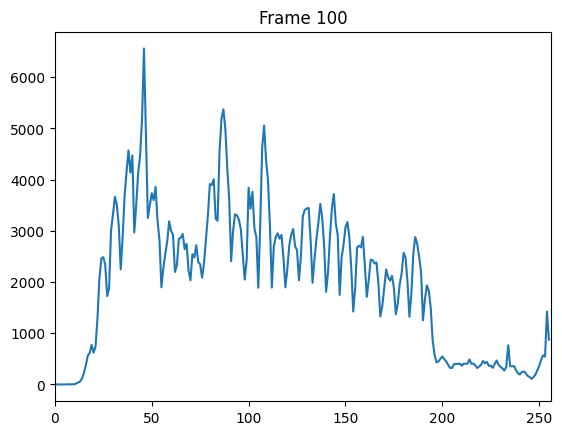

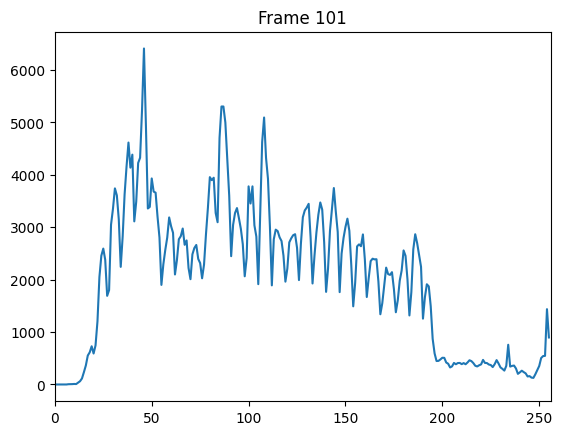

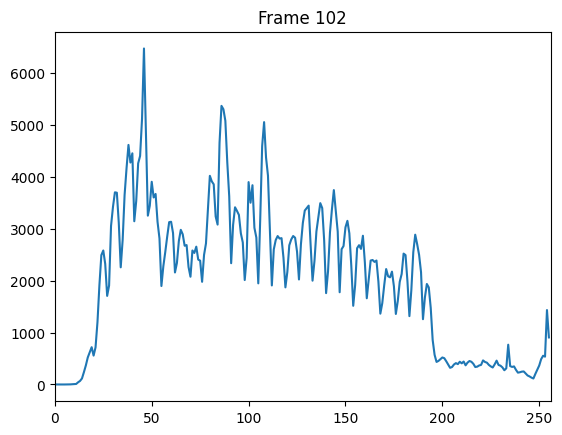

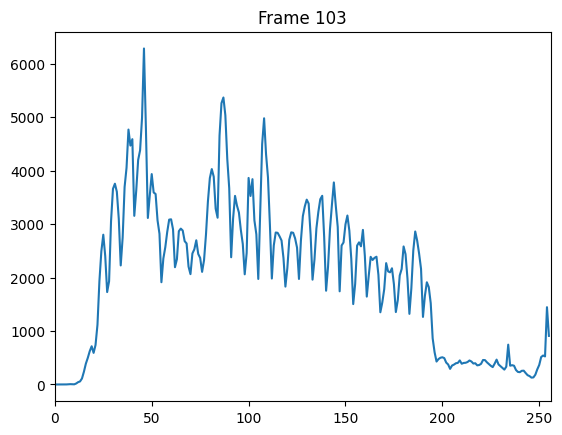

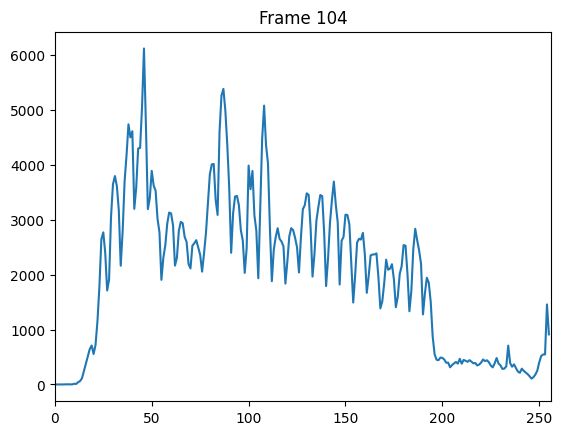

...

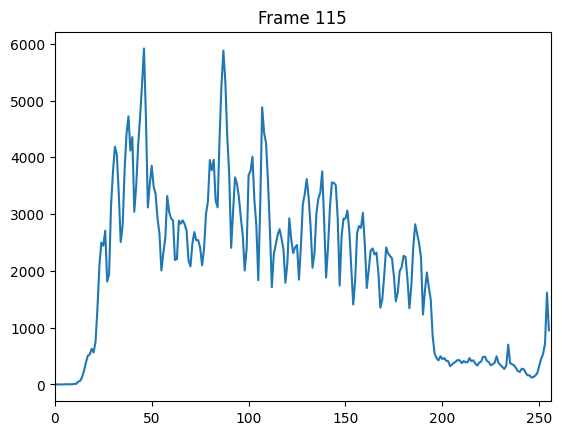

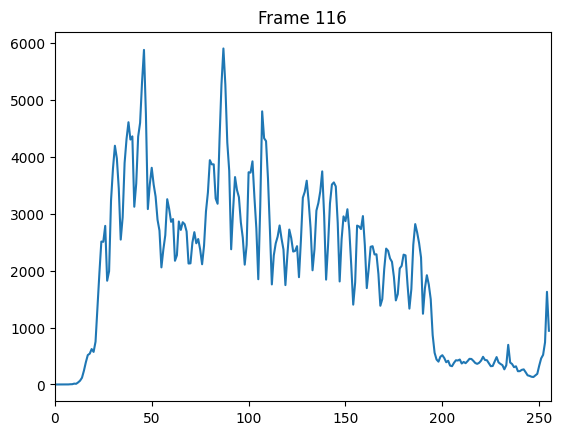

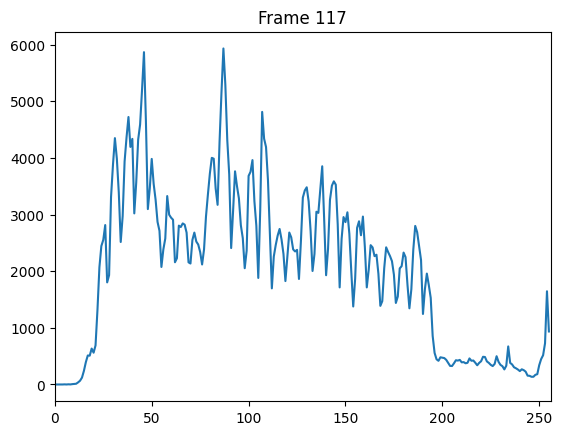

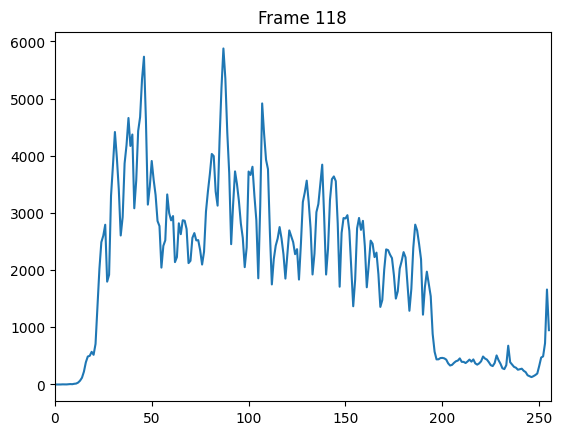

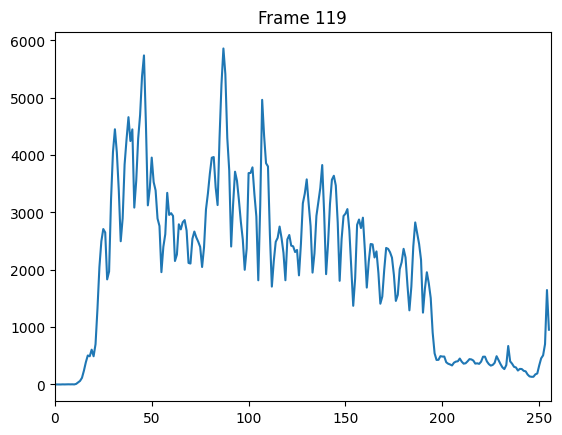

In [13]:
for i in range(100,120):
  image = cv2.imread("greyframe%d.jpg" % i)  # Read grayscale image
  hist = cv2.calcHist([image],[0],None,[256],[0,256])  # Compute histogram of pixel intensities
  plt.figure()
  plt.plot(hist)  # Plot the histogram
  plt.title('Frame ' + str(i))
  plt.xlim([0,256])  # Limit x-axis to [0, 256] for pixel values

## Histogram Equalization

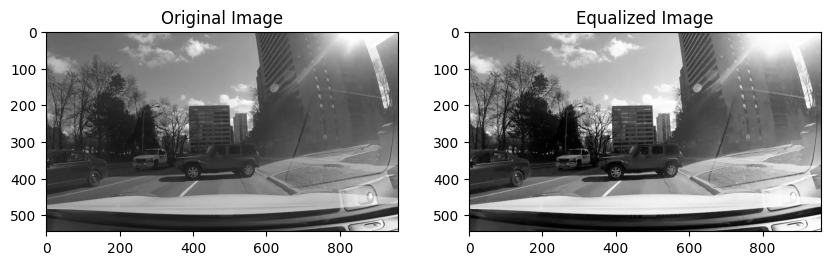

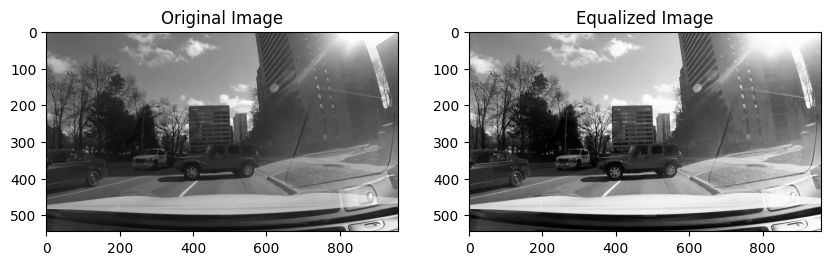

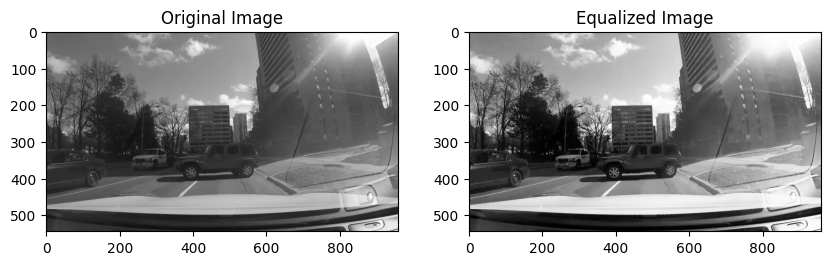

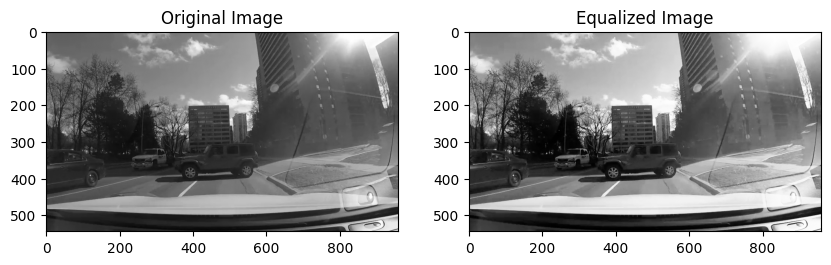

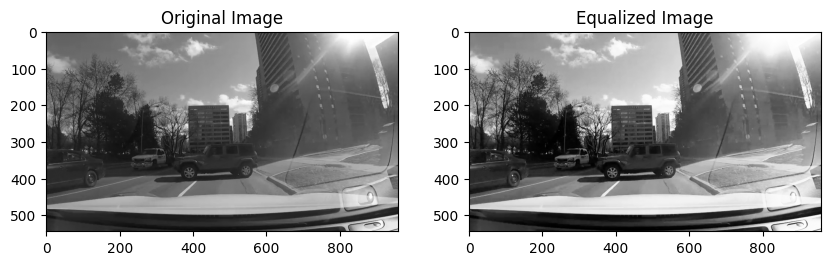

...

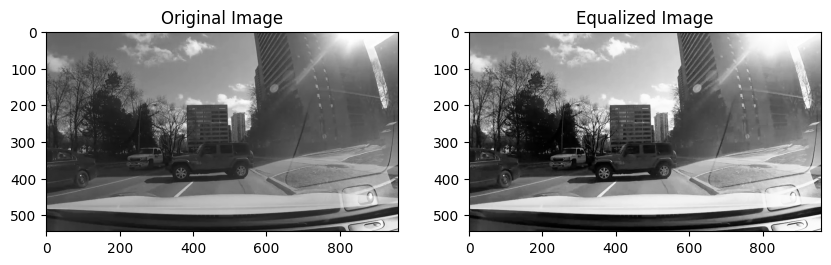

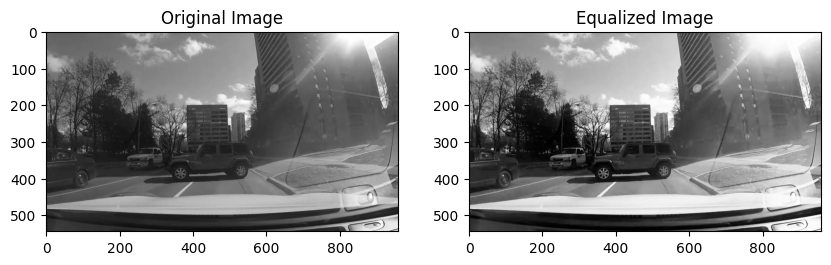

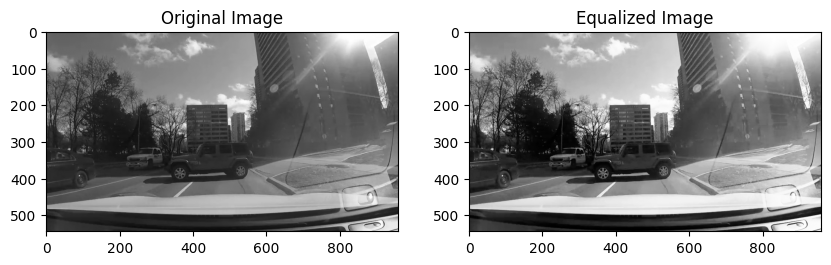

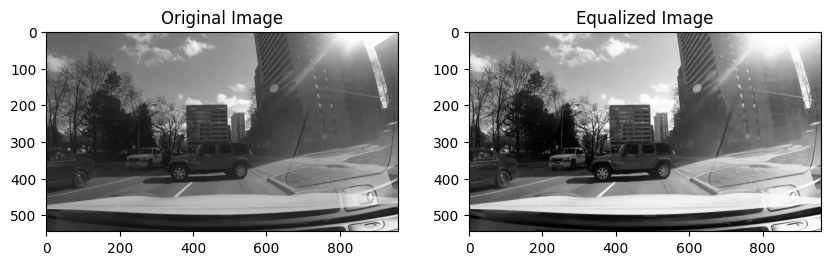

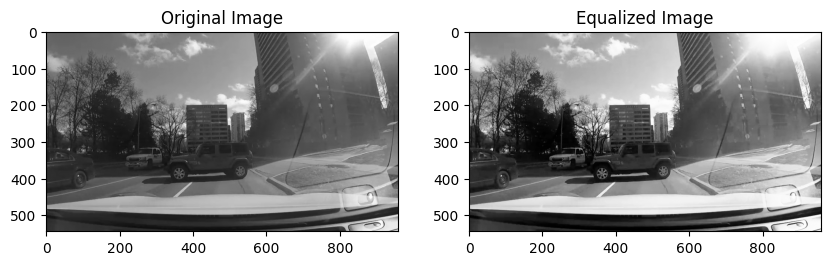

In [14]:
for i in range(100, 120):
  image = cv2.imread("greyframe%d.jpg" % i, cv2.IMREAD_GRAYSCALE)  # Load grayscale image
  eq = cv2.equalizeHist(image)  # Apply histogram equalization to improve contrast

  fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 5))  # Create side-by-side subplots

  ax1.imshow(image, cmap='gray')  # Show original image
  ax1.set_title('Original Image')

  ax2.imshow(eq, cmap='gray')  # Show equalized image
  ax2.set_title('Equalized Image')
  plt.show()

## Fourier Transform

### Applying the Fourier Transform

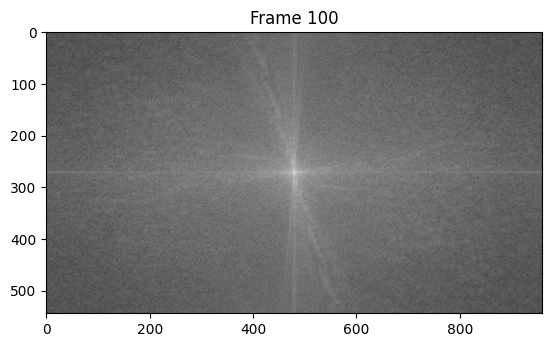

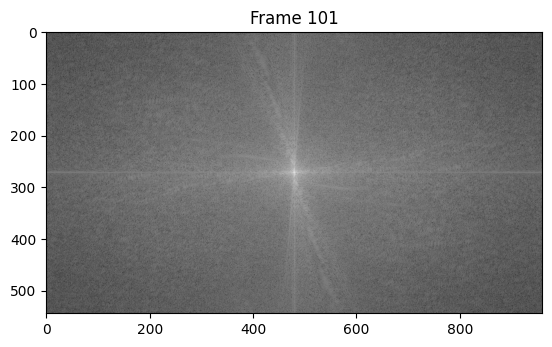

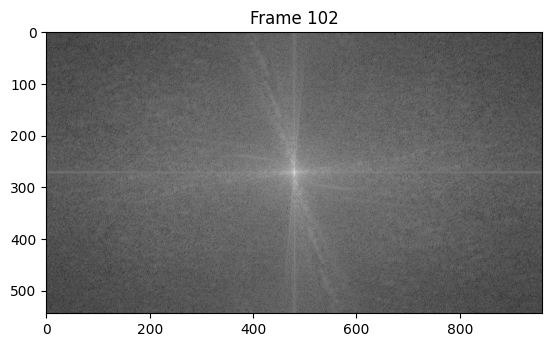

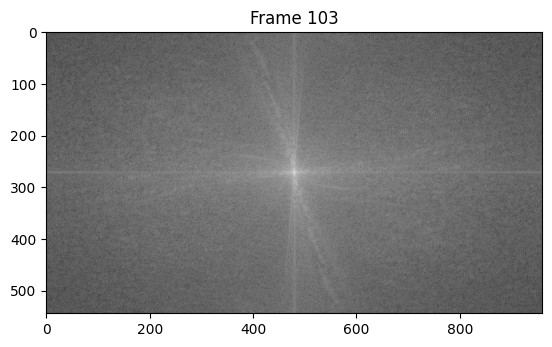

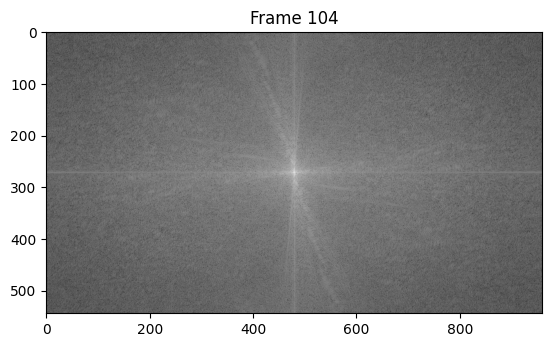

...

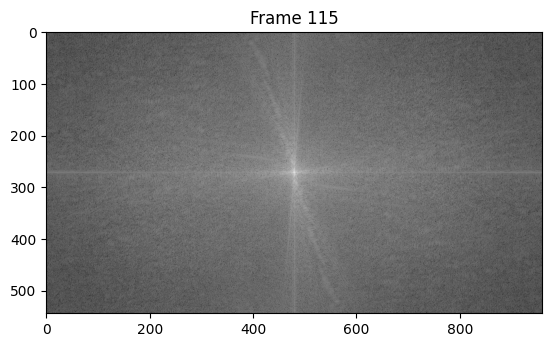

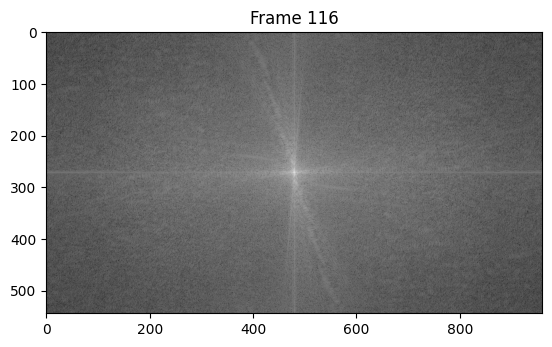

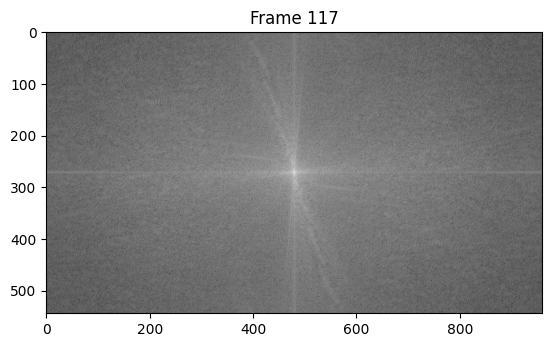

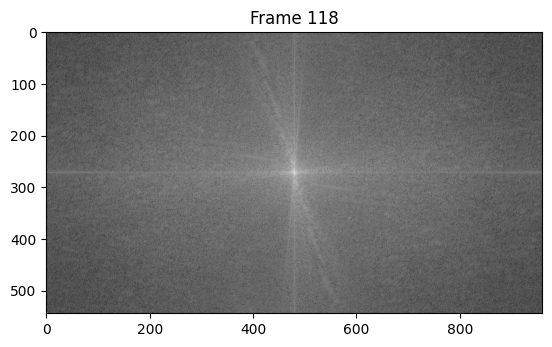

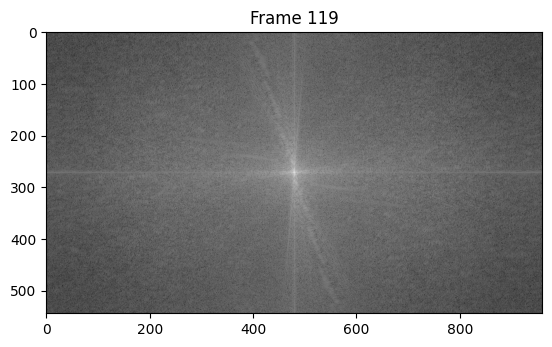

In [15]:
for i in range(100,120):
  image = cv2.imread("greyframe%d.jpg" % i, cv2.IMREAD_GRAYSCALE)  # Load grayscale image
  f = np.fft.fft2(image)  # Perform 2D Fast Fourier Transform
  fshift = np.fft.fftshift(f)  # Shift the zero frequency component to the center
  plt.imshow(np.log(1 + np.abs(fshift)), cmap='gray')  # Visualize magnitude spectrum in log scale
  plt.title('Frame ' + str(i))
  plt.show()

### Removing high-frequency noise and reconstructing image

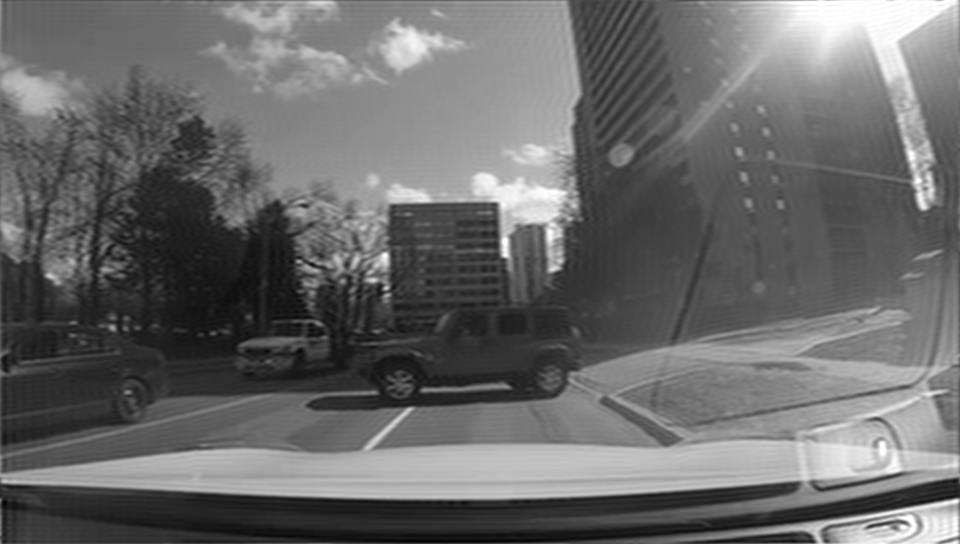

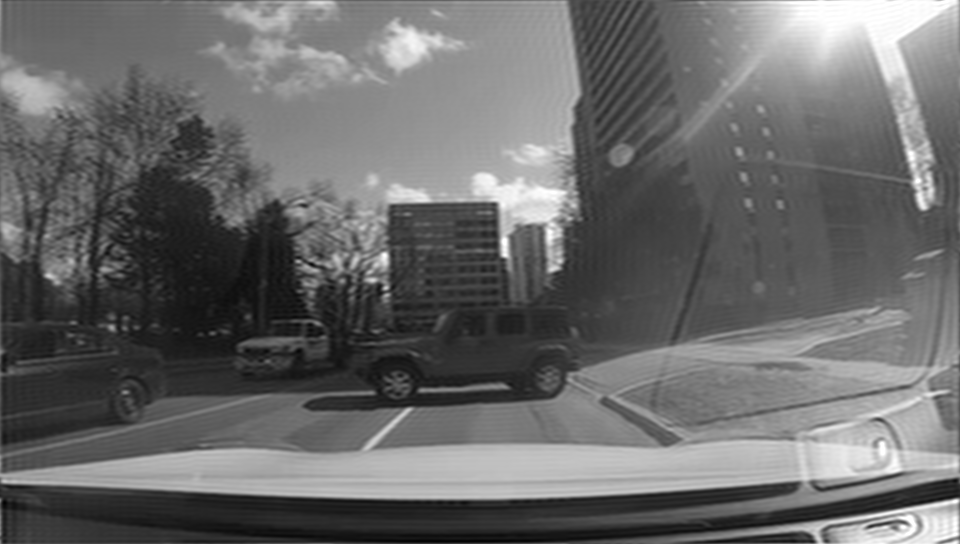

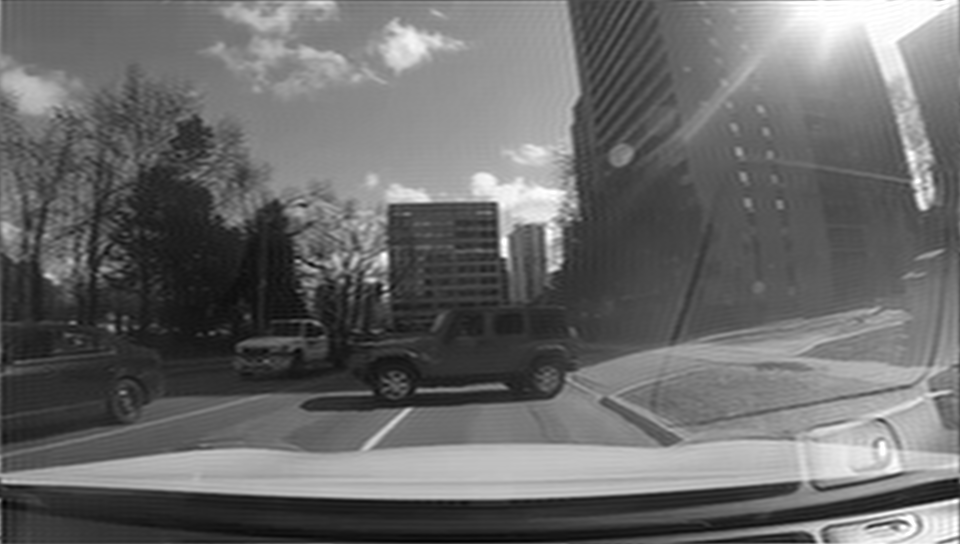

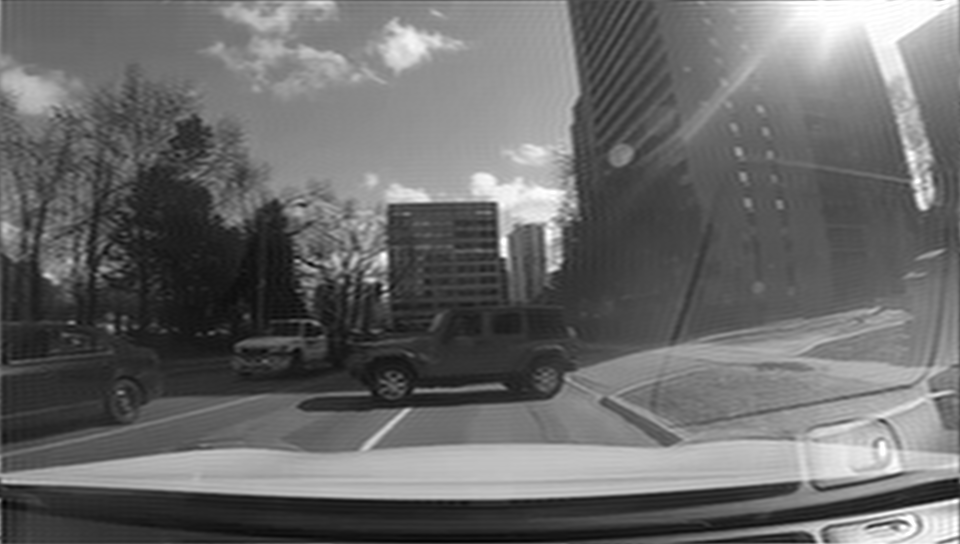

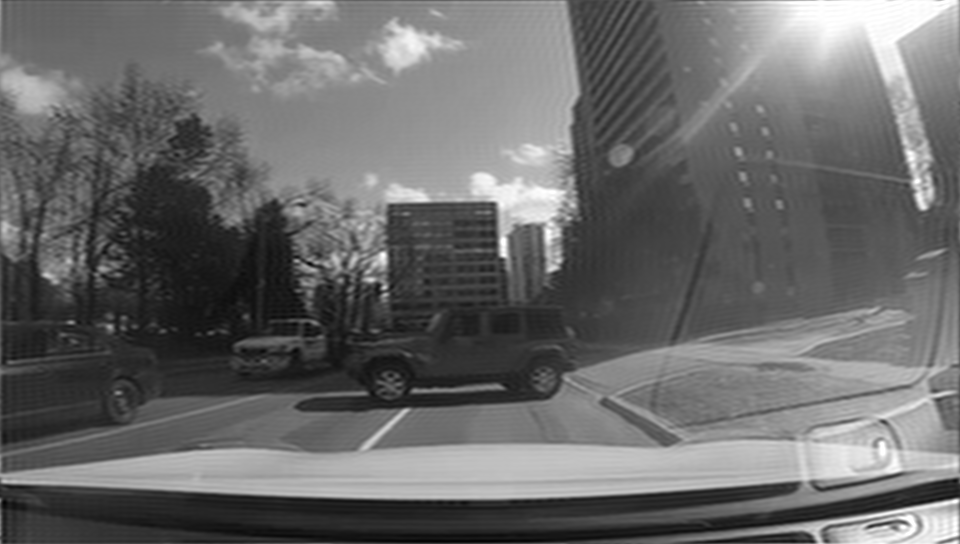

...

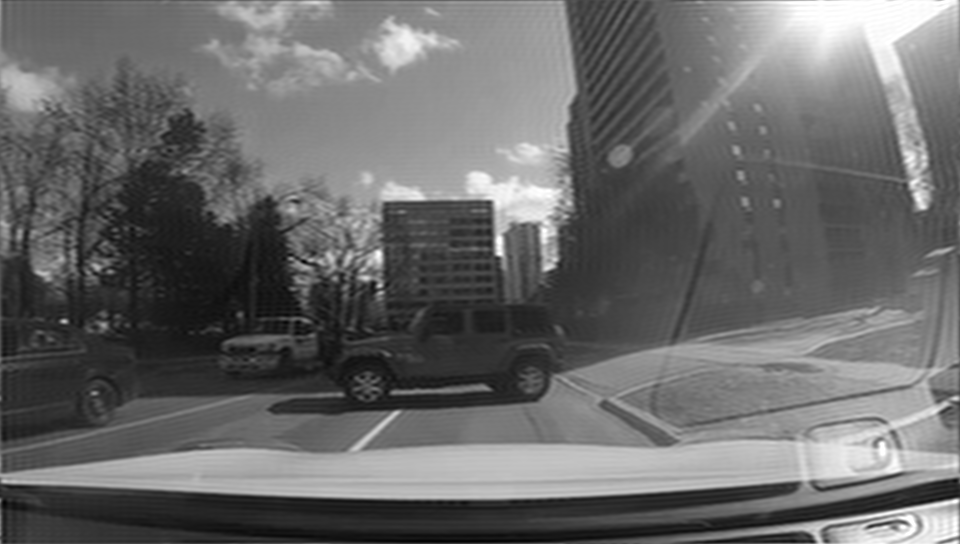

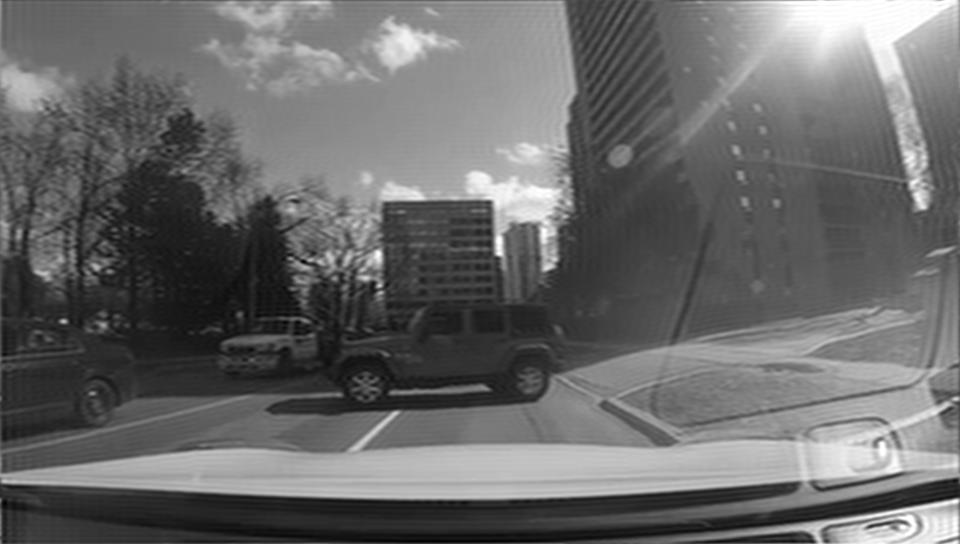

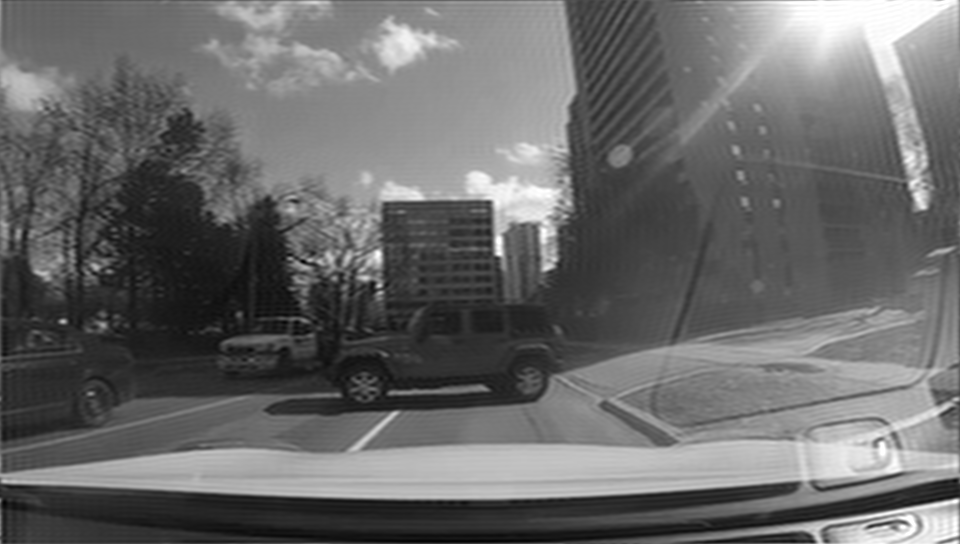

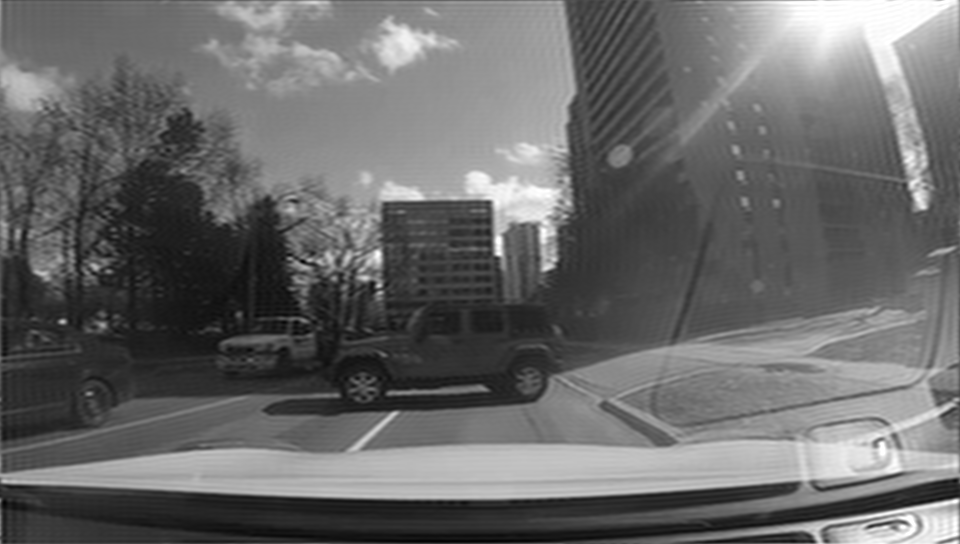

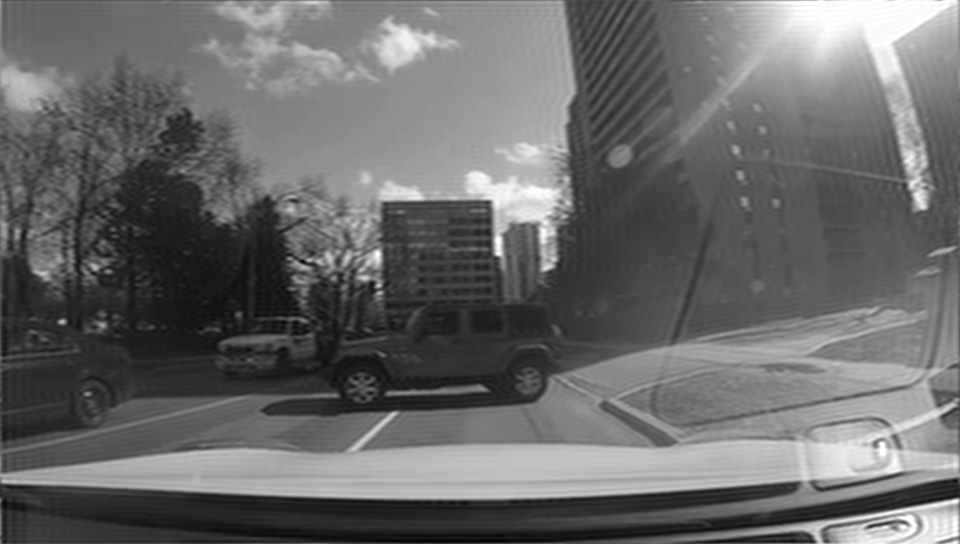

In [16]:
for i in range(100, 120):
    image = cv2.imread("greyframe%d.jpg" % i, cv2.IMREAD_GRAYSCALE)  # Load grayscale image

    f = np.fft.fft2(image)  # Perform 2D FFT
    fshift = np.fft.fftshift(f)  # Shift zero frequency to center

    rows, cols = image.shape
    crow, ccol = rows // 2, cols // 2
    mask = np.zeros((rows, cols), np.uint8)  # Create a mask with zeros
    mask[crow - 100:crow + 100, ccol - 100:ccol + 100] = 1 # Changing the value here affects how much the image is blurred

    fshift = fshift * mask  # Apply the mask to the frequency domain image

    f_ishift = np.fft.ifftshift(fshift)  # Inverse shift
    img_back = np.fft.ifft2(f_ishift)  # Inverse FFT to get blurred image
    img_back = np.abs(img_back)  # Get magnitude (discard imaginary part)

    cv2_imshow(img_back)  # Display the blurred image


## Edge Detection

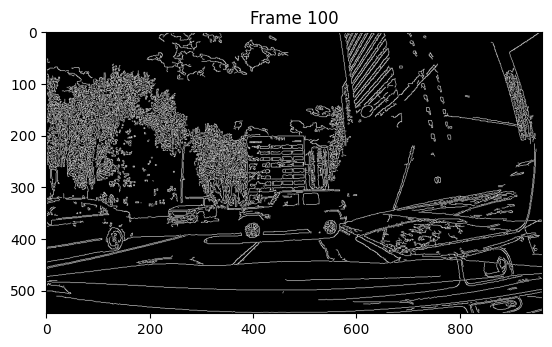

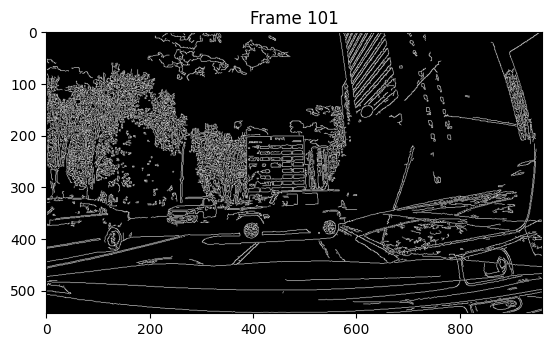

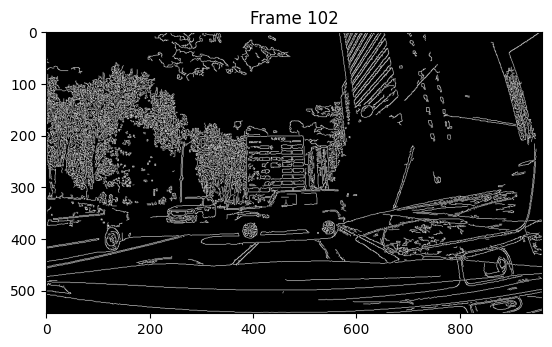

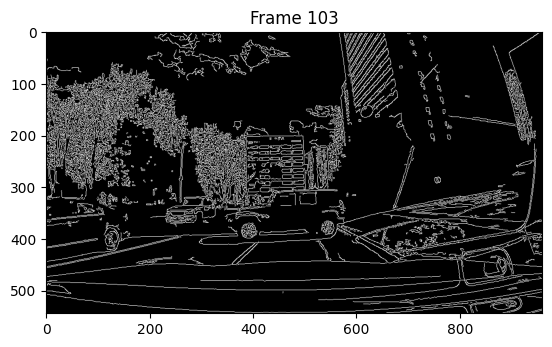

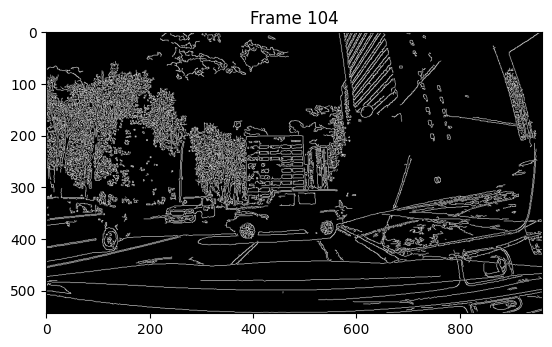

...

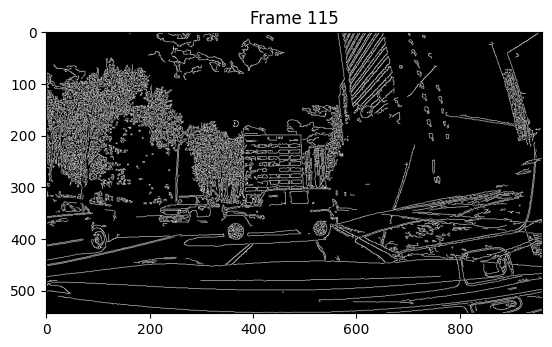

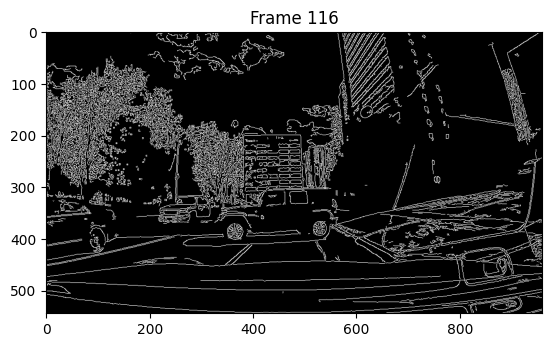

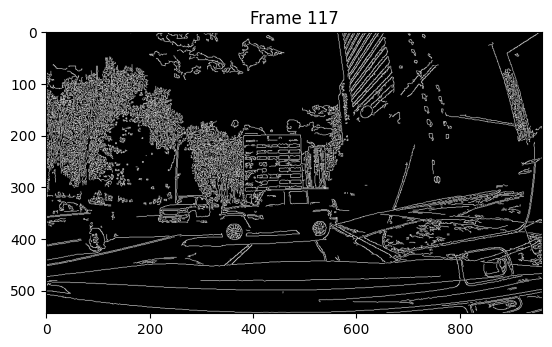

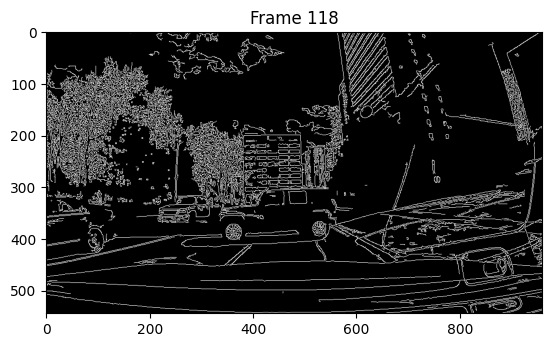

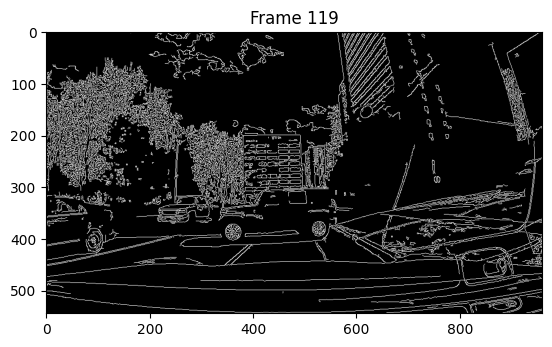

In [22]:
for i in range(100,120):
  image = cv2.imread("greyframe%d.jpg" % i, cv2.IMREAD_GRAYSCALE)  # Load grayscale image
  edges =  cv2.Canny(image, threshold1=30, threshold2=100)  # Apply Canny edge detection
  plt.imshow(edges, cmap='gray')  # Show edges
  plt.title('Frame ' + str(i))
  plt.show()

## Kernel Filtering

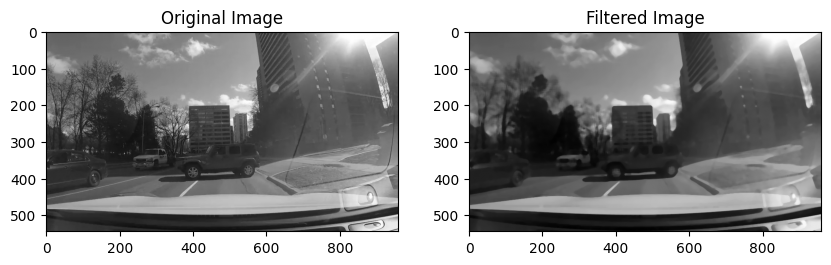

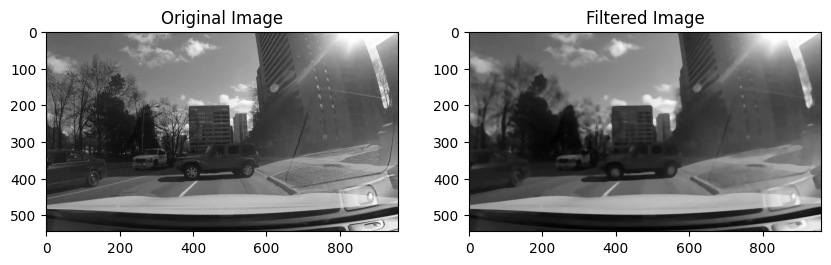

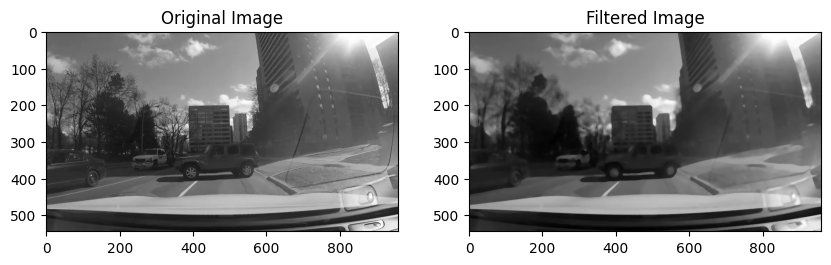

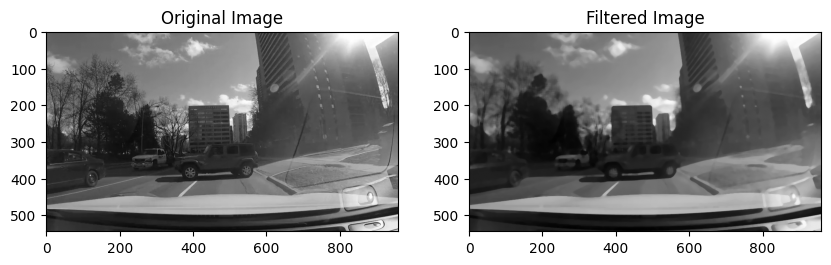

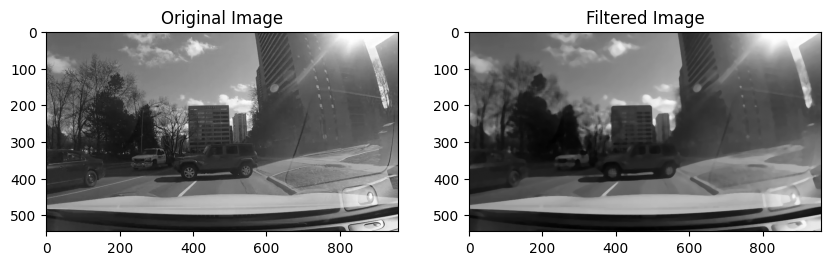

...

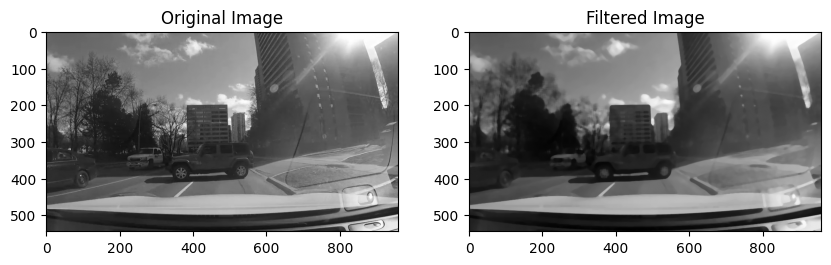

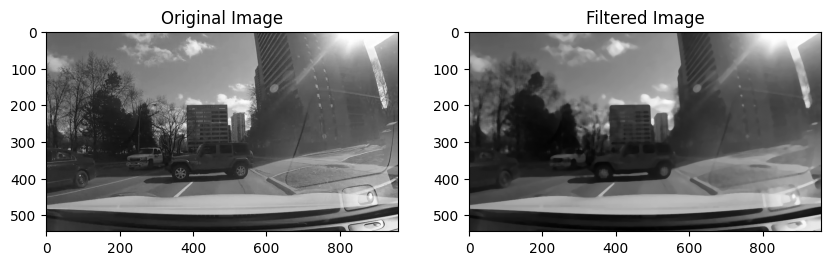

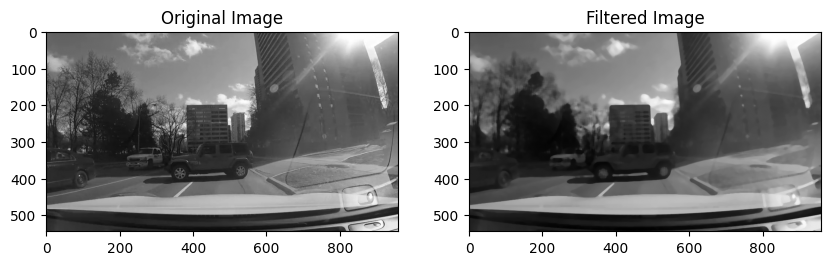

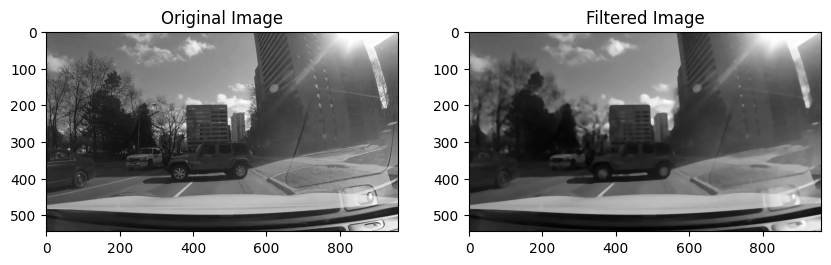

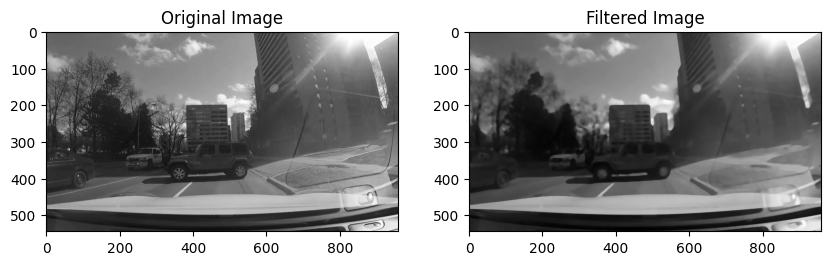

In [23]:
for i in range(100,120):
  image = cv2.imread("greyframe%d.jpg" %i, cv2.IMREAD_GRAYSCALE)  # Load grayscale image
  filtered = cv2.medianBlur(image, ksize=9) # Apply median blur to reduce noise (larger ksize = stronger blur)
  fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 5))  # Create side-by-side subplots

  ax1.imshow(image, cmap='gray')  # Show original image
  ax1.set_title('Original Image')

  ax2.imshow(filtered, cmap='gray')  # Show filtered image
  ax2.set_title('Filtered Image')
  plt.show()

# Task implementation

In [ ]:
# Open the input video
cap = cv2.VideoCapture('/content/video2.mp4')
if not cap.isOpened():
    raise IOError("Error opening video file")

# Get video properties for output video
frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = cap.get(cv2.CAP_PROP_FPS)

# Create VideoWriter object for output video
fourcc = cv2.VideoWriter_fourcc(*'mp4v')  # Use appropriate codec for your system
out = cv2.VideoWriter('/content/highlighted_lanes.mp4', fourcc, fps, (frame_width, frame_height))

while True:
    ret, frame = cap.read()
    if not ret:
        break

    # Convert frame to grayscale
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    # Apply Gaussian blur to reduce noise
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)

    # Apply Canny edge detection
    edges = cv2.Canny(blurred, 50, 150)

    # Apply dilation to connect broken lane lines
    kernel = np.ones((3, 3), np.uint8)
    dilated_edges = cv2.dilate(edges, kernel, iterations=1)

    # Create a colored output to better visualize the lanes
    color_img = cv2.cvtColor(gray, cv2.COLOR_GRAY2BGR)

    # Overlay lanes in green
    color_img[dilated_edges > 0] = [0, 255, 0]

    # Write the processed frame to the output video
    out.write(color_img)

# Release resources
cap.release()
out.release()

print(f"Lane highlighting complete. Results saved to {'/content/highlighted_lanes.mp4'}")

Lane highlighting complete. Results saved to /content/highlighted_lanes.mp4


## Discussion

### Histogram Analysis & Equalization
Histogram analysis provides insight into the lighting and contrast conditions of a scene. In real-world driving, environments vary greatly—bright sunlight, tunnels, night driving. Histogram equalization enhances contrast, helping the system better detect lanes, pedestrians, or obstacles in low-visibility conditions.

### Fourier Transform
The Fourier transform is effective in detecting periodic patterns and textures. In autonomous systems, it can help differentiate road textures from sidewalks or grassy areas. It also aids in filtering out high-frequency noise and improving signal-to-noise ratio in the visual feed.

### Edge Detection
Edge detection (e.g., via Canny or Sobel) identifies the structural outlines of objects. It’s critical for recognizing lane markings, road boundaries, vehicles, and pedestrians. These edges are often fed into more complex object detection or segmentation models.


### Kernel Filters
Kernel-based filters (like Gaussian blur, sharpening, or custom convolutions) are essential preprocessing steps. They help smooth noisy footage, enhance details, and highlight features before passing the frame to higher-level perception models like neural networks.

Together, these techniques help autonomous vehicles understand the driving environment, especially when paired with real-time data from sensors like LIDAR or radar. Even before applying deep learning, these classical methods contribute to robust and efficient preprocessing, especially useful in edge devices where resources are limited.

### Summary
Together, these techniques help autonomous vehicles understand the driving environment, especially when paired with real-time data from sensors like LIDAR or radar. Even before applying deep learning, these classical methods contribute to robust and efficient preprocessing, especially useful in edge devices where resources are limited.

# Bonus

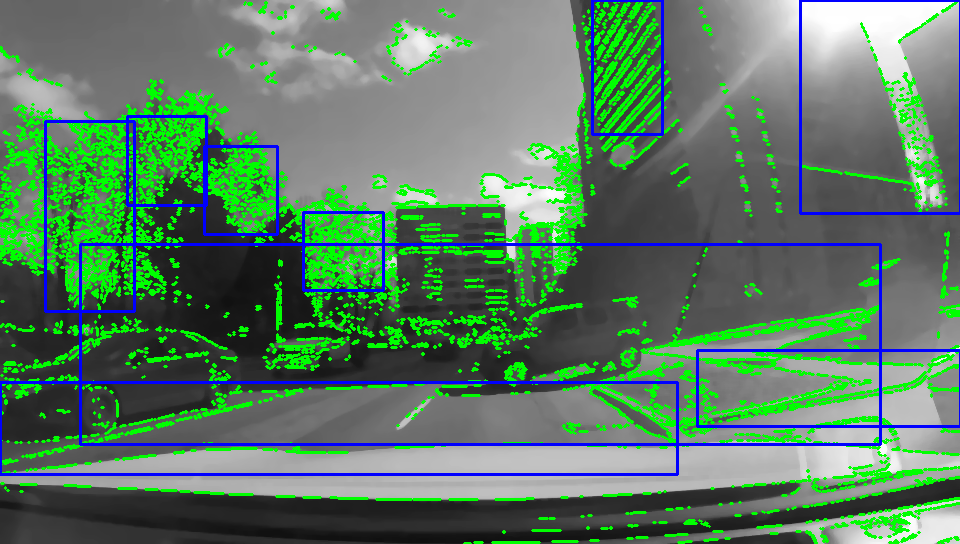

In [ ]:
# Load the grayscale image
gray = cv2.imread('frame51.jpg', cv2.IMREAD_GRAYSCALE)
frame = cv2.cvtColor(gray, cv2.COLOR_GRAY2BGR)  # Convert to BGR to draw colored lines
frame = cv2.medianBlur(frame, ksize=7)
# Edge detection
edges = cv2.Canny(gray, 50, 150)

# Hough Transform for lane-like lines
lines = cv2.HoughLinesP(edges, 1, np.pi/180, threshold=50, minLineLength=1, maxLineGap=0.2) #changing these values will change how the edge detection works
if lines is not None:
    for line in lines:
        x1, y1, x2, y2 = line[0]
        cv2.line(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)  # Green lines

# Contour detection for object boundaries
contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
for cnt in contours:
    area = cv2.contourArea(cnt)
    if area > 500:  # Filter out small edges
        x, y, w, h = cv2.boundingRect(cnt)
        cv2.rectangle(frame, (x, y), (x+w, y+h), (255, 0, 0), 2)  # Blue boxes

# Show result
cv2_imshow(frame)